In [1]:
!pip install rasterio

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 21.3/21.3 MB 51.8 MB/s eta 0:00:00


In [2]:
# !pip install segmentation-models-pytorch
!pip install -U segmentation-models

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 50.7/50.7 kB 5.6 MB/s eta 0:00:00


In [3]:
!pip install onnxruntime

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 5.9/5.9 MB 79.9 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 46.0/46.0 kB 5.1 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 86.8/86.8 kB 11.3 MB/s eta 0:00:00


In [4]:
%%shell
wget -c https://repo.anaconda.com/miniconda/Miniconda3-4.5.4-Linux-x86_64.sh
chmod +x Miniconda3-4.5.4-Linux-x86_64.sh
bash ./Miniconda3-4.5.4-Linux-x86_64.sh -b -f -p /usr/local
conda install -q -y --prefix /usr/local python=3.6 gdal

--2023-07-04 11:06:51--  https://repo.anaconda.com/miniconda/Miniconda3-4.5.4-Linux-x86_64.sh
Resolving repo.anaconda.com (repo.anaconda.com)... 104.16.130.3, 104.16.131.3, 2606:4700::6810:8203, ...
Connecting to repo.anaconda.com (repo.anaconda.com)|104.16.130.3|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 58468498 (56M) [application/x-sh]
Saving to: ‘Miniconda3-4.5.4-Linux-x86_64.sh’

Miniconda3-4.5.4-Li 100%[===================>]  55.76M   114MB/s    in 0.5s    

2023-07-04 11:06:51 (114 MB/s) - ‘Miniconda3-4.5.4-Linux-x86_64.sh’ saved [58468498/58468498]

PREFIX=/usr/local
installing: python-3.6.5-hc3d631a_2 ...
Python 3.6.5 :: Anaconda, Inc.
installing: ca-certificates-2018.03.07-0 ...
installing: conda-env-2.6.0-h36134e3_1 ...
installing: libgcc-ng-7.2.0-hdf63c60_3 ...
installing: libstdcxx-ng-7.2.0-hdf63c60_3 ...
installing: libffi-3.2.1-hd88cf55_4 ...
installing: ncurses-6.1-hf484d3e_0 ...
installing: openssl-1.0.2o-h20670df_0 ...
installing: tk-8.6

In [5]:
import rasterio
from PIL import Image
import cv2
import os
import numpy as np
import matplotlib.pyplot as plt
from google.colab.patches import cv2_imshow
import tensorflow as tf

In [6]:
from osgeo import gdal
from osgeo import ogr
from osgeo import osr
from osgeo import gdal_array
from osgeo import gdalconst

In [7]:
os.environ['SM_FRAMEWORK'] = "tf.keras"
import segmentation_models as sm

Segmentation Models: using `tf.keras` framework.


In [8]:
def get_image_RGB(filename):
    image = gdal.Open(filename, gdal.GA_ReadOnly)
    # As, there are 3 bands, we will store in 3 different variables
    band_1 = image.GetRasterBand(1) # red channel
    band_2 = image.GetRasterBand(2) # green channel
    band_3 = image.GetRasterBand(3) # blue channel
    #band_4 = image.GetRasterBand(4) # alpha channel
    b1 = band_1.ReadAsArray()
    b2 = band_2.ReadAsArray()
    b3 = band_3.ReadAsArray()
    # b4 = band_4.ReadAsArray()
    # Normalize input image to range [0, 255]
    normalized_b1 = cv2.normalize(b1, None, 0, 255, cv2.NORM_MINMAX, cv2.CV_8U)
    normalized_b2 = cv2.normalize(b2, None, 0, 255, cv2.NORM_MINMAX, cv2.CV_8U)
    normalized_b3 = cv2.normalize(b3, None, 0, 255, cv2.NORM_MINMAX, cv2.CV_8U)
    return np.dstack((normalized_b1, normalized_b2, normalized_b3))


def get_image_RGB_2(filename):
    with rasterio.open(filename) as src:
        geotiff_bytes = src.read()

    b1 = geotiff_bytes[0, :, :]
    b2 = geotiff_bytes[1, :, :]
    b3 = geotiff_bytes[2, :, :]

    # Normalize input image to range [0, 255]
    normalized_b1 = cv2.normalize(b1, None, 0, 255, cv2.NORM_MINMAX, cv2.CV_8U)
    normalized_b2 = cv2.normalize(b2, None, 0, 255, cv2.NORM_MINMAX, cv2.CV_8U)
    normalized_b3 = cv2.normalize(b3, None, 0, 255, cv2.NORM_MINMAX, cv2.CV_8U)
    return np.dstack((normalized_b1, normalized_b2, normalized_b3))

In [9]:
def find_contours(thresh):
    # Find the contours in the input image
    contours, hierarchy = cv2.findContours(thresh, cv2.RETR_TREE, cv2.CHAIN_APPROX_NONE)

    return contours


def draw_contours(contours, image):

    # Draw the contours on an image
    contour_img = cv2.drawContours(image, contours, -1, (0, 255, 0), 5)

    return contour_img

def connected_components(closed, threshold_area=250, connectivity=8):
    # clone our original image (so we can draw on it) and then draw
    # a bounding box surrounding the connected component along with
    # a circle corresponding to the centroid

    # perform connected component analysis
    # apply connected component analysis to the thresholded image
    output = cv2.connectedComponentsWithStats(closed, connectivity, cv2.CV_32S)
    (numLabels, labels, stats, centroids) = output
    # initialize an output mask to store all forests parsed from
    # the image
    mask = np.zeros(closed.shape, dtype="uint8")
    print(numLabels)
    # loop over the number of unique connected component labels
    for i in range(1, numLabels):
        # extract the connected component statistics and centroid for
        # the current label
        x = stats[i, cv2.CC_STAT_LEFT]
        y = stats[i, cv2.CC_STAT_TOP]
        w = stats[i, cv2.CC_STAT_WIDTH]
        h = stats[i, cv2.CC_STAT_HEIGHT]
        area = stats[i, cv2.CC_STAT_AREA]
        # ensure the width, height, and area are all neither too small
        # nor too big
        keepWidth = w > 10
        keepHeight = h > 10
        keepArea = area >= threshold_area
        if all((keepWidth, keepHeight, keepArea)):
            componentMask = (labels == i).astype("uint8") # * 255

            mask = cv2.bitwise_or(mask, componentMask)

    return mask

In [10]:
class AnomalyRoads():
    '''
        Класс для нахождения дорог на изображении.
    '''

    def __init__(self, image_RGB, path_to_model):
        self.name = 'Roads'
        self.color = 'red'
        self.BACKBONE = 'resnet50'
        self.path_to_model = path_to_model
        self.image_RGB = image_RGB.copy()
        CLASSES = ['road']
        self.n_classes = 1 if len(CLASSES) == 1 else (len(CLASSES) + 1)
        self.activation = 'sigmoid' if self.n_classes == 1 else 'softmax'
        self.model = sm.Unet(self.BACKBONE, classes=self.n_classes, activation=self.activation)
        self.model.load_weights(self.path_to_model)  # self.roads_


    def find_contours_of_anomaly(self):
        '''
        Использование нейросети для нахождения областей дорог.
        '''

        image_RGB = self.image_RGB.copy()
        print(image_RGB.shape)
        shape_image = image_RGB.shape
        img = cv2.resize(image_RGB, (512, 512))
        image = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)


        preprocessing_fn = sm.get_preprocessing(self.BACKBONE)
        image = preprocessing_fn(image)

        image = np.expand_dims(image, axis=0)

        pr_mask = self.model.predict(image).round()
        pr_mask=pr_mask[..., 0].squeeze()
        pr_mask = (pr_mask * 255).astype(np.uint8)
        plt.imshow(pr_mask)
        plt.show()

        # Find the contours in the input image
        contours, _ = cv2.findContours(pr_mask, cv2.RETR_TREE, cv2.CHAIN_APPROX_NONE)

        areas = [cv2.contourArea(contour) for contour in contours]
        mean_area = np.mean(areas)
        std_area = np.std(areas)
        print("Mean area: {} +- {}".format(mean_area, std_area))
        threshold_area = mean_area # - std_area

        pr_mask = connected_components(pr_mask, threshold_area=threshold_area)
        pr_mask = cv2.resize(pr_mask, (shape_image[1], shape_image[0]))
        plt.imshow(pr_mask)
        plt.show()

        # Find the contours in the input image
        contours, _ = cv2.findContours(pr_mask, cv2.RETR_TREE, cv2.CHAIN_APPROX_NONE)

        return contours

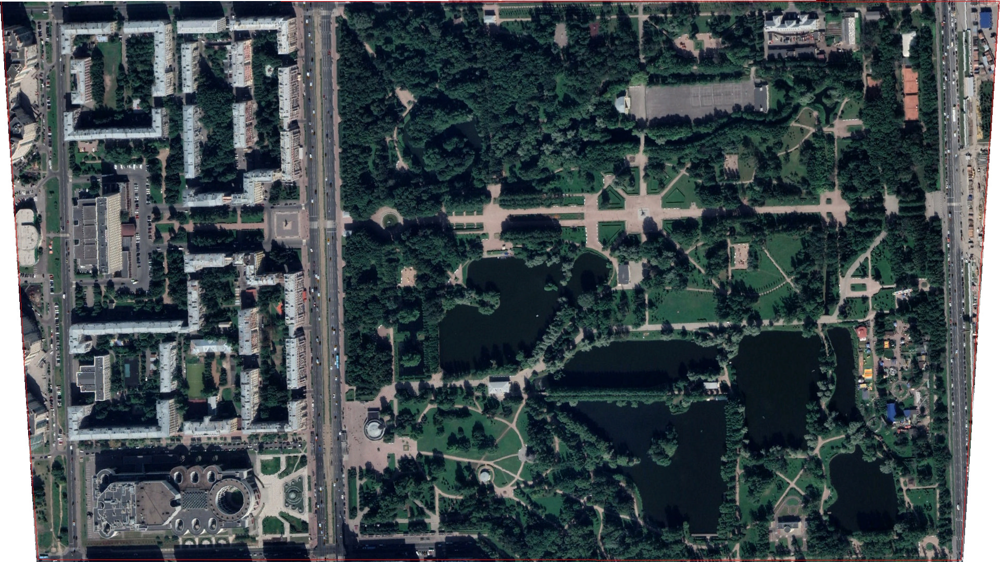

94592056/94592056 [==============================] - 1s 0us/step


In [11]:
FILENAME = 'park_1.tif'
image_RGB = get_image_RGB_2(FILENAME)
image_pill = Image.fromarray(image_RGB)
image_pill.show()

anomaly_roads = AnomalyRoads(image_RGB, '/content/unet_road.h5')

(1080, 1920, 3)
1/1 [==============================] - 4s 4s/step


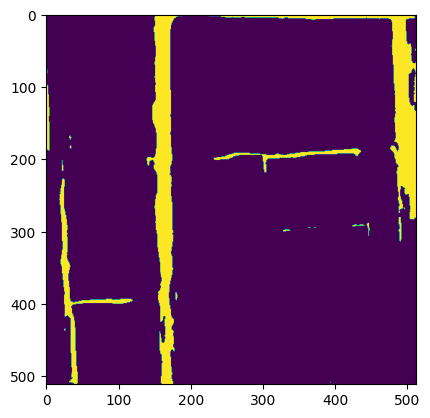

Mean area: 916.0 +- 2416.8232671309365
23


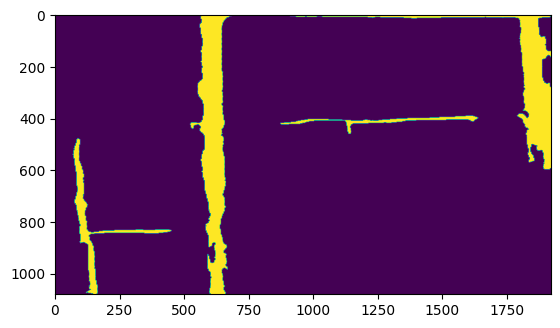

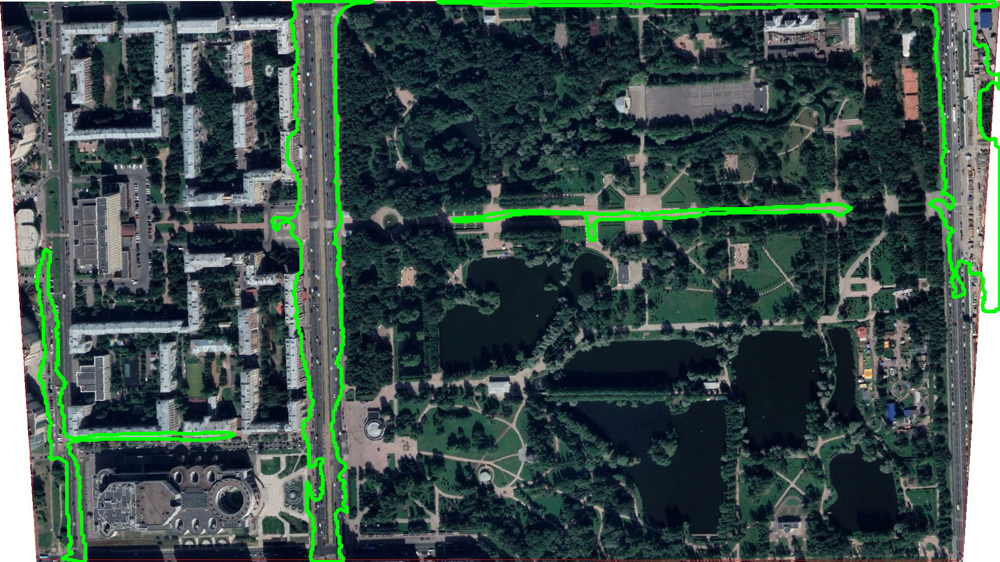

In [12]:
contours = anomaly_roads.find_contours_of_anomaly()
contour_img = draw_contours(contours, image_RGB.copy())
contour_img_pill = Image.fromarray(contour_img)
contour_img_pill.show()

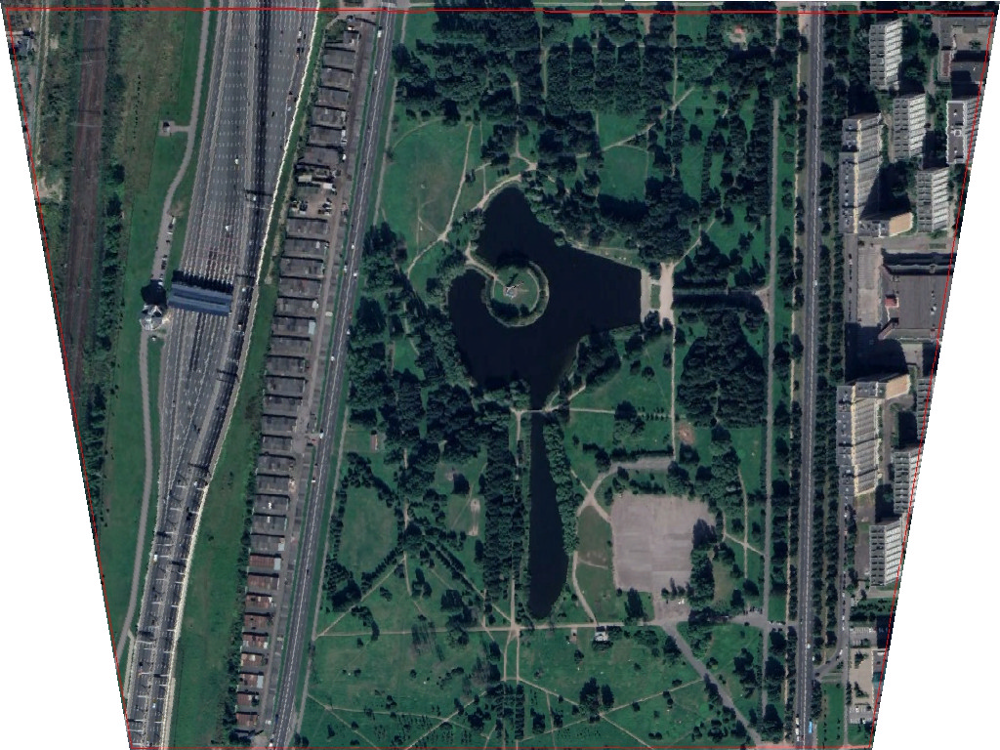

In [13]:
FILENAME = 'park_2.tif'
image_RGB = get_image_RGB_2(FILENAME)
image_pill = Image.fromarray(image_RGB)
image_pill.show()

anomaly_roads = AnomalyRoads(image_RGB, '/content/unet_road.h5')

(768, 1024, 3)
1/1 [==============================] - 3s 3s/step


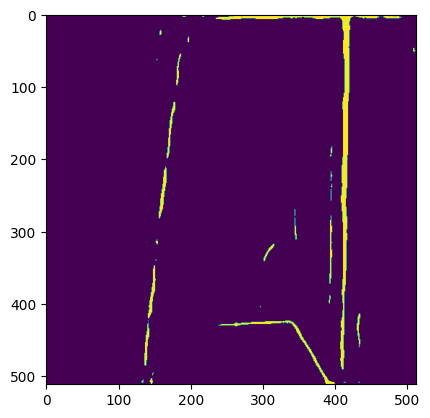

Mean area: 158.40625 +- 598.9110357231176
33


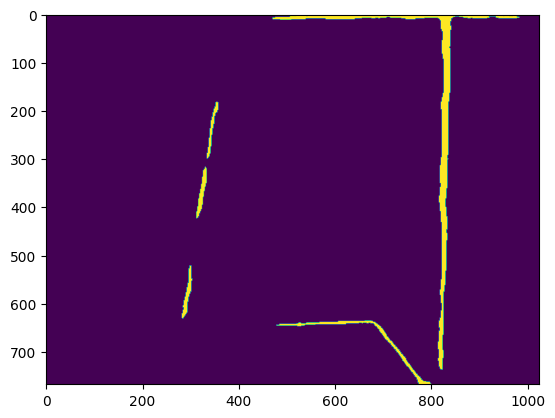

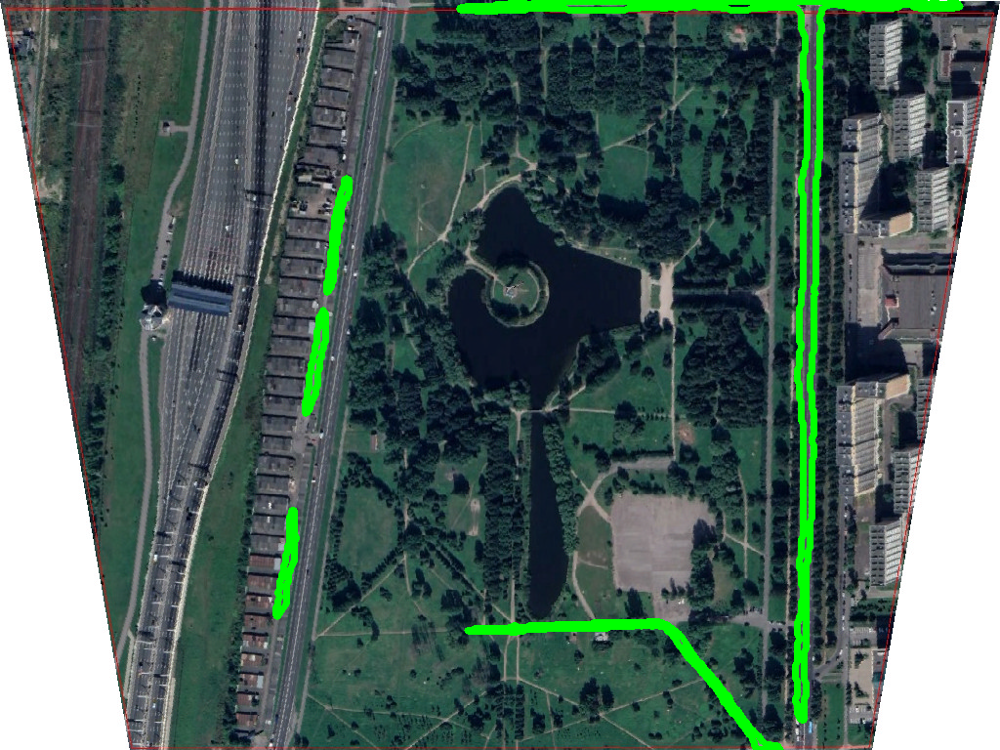

In [14]:
contours = anomaly_roads.find_contours_of_anomaly()
contour_img = draw_contours(contours, image_RGB.copy())
contour_img_pill = Image.fromarray(contour_img)
contour_img_pill.show()

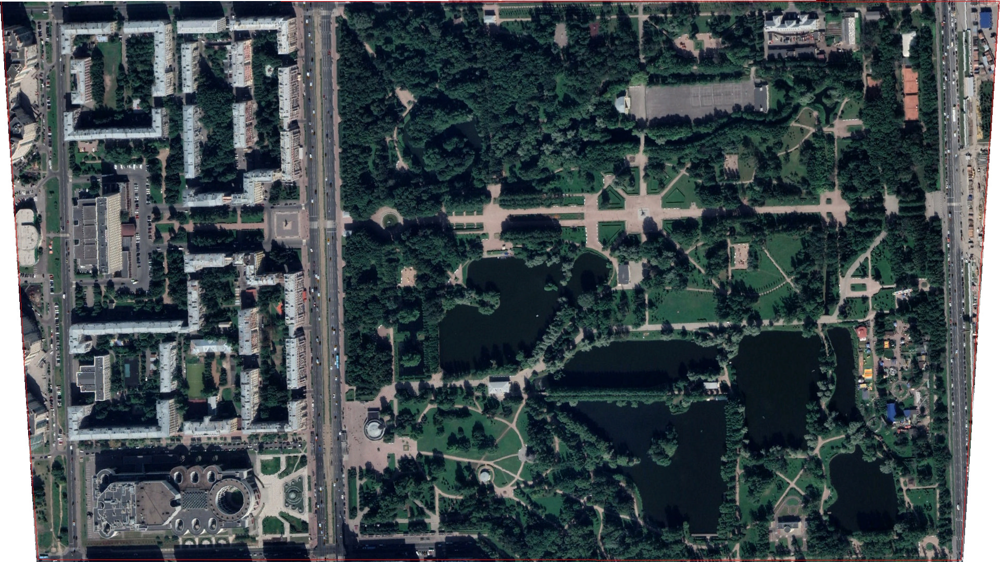

In [83]:
FILENAME = 'park_1.tif'
image_RGB = get_image_RGB_2(FILENAME)
image_pill = Image.fromarray(image_RGB)
image_pill.show()

anomaly_roads = AnomalyRoads(image_RGB, '/content/unet_road_2.h5')

(1080, 1920, 3)
1/1 [==============================] - 3s 3s/step


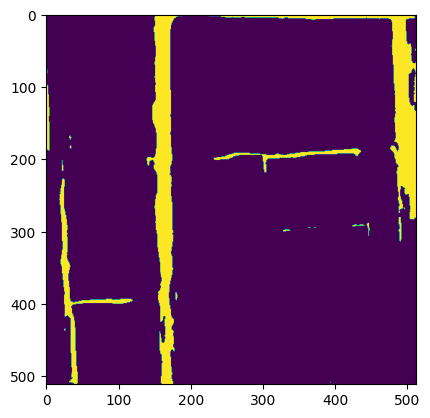

Mean area: 916.0 +- 2416.8232671309365
23


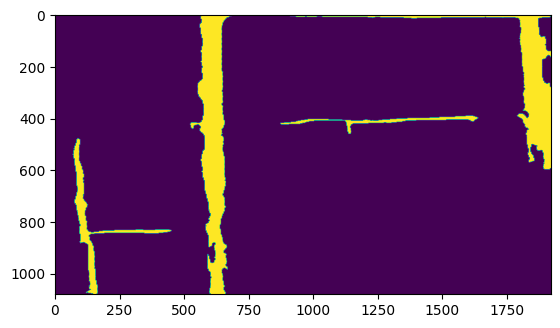

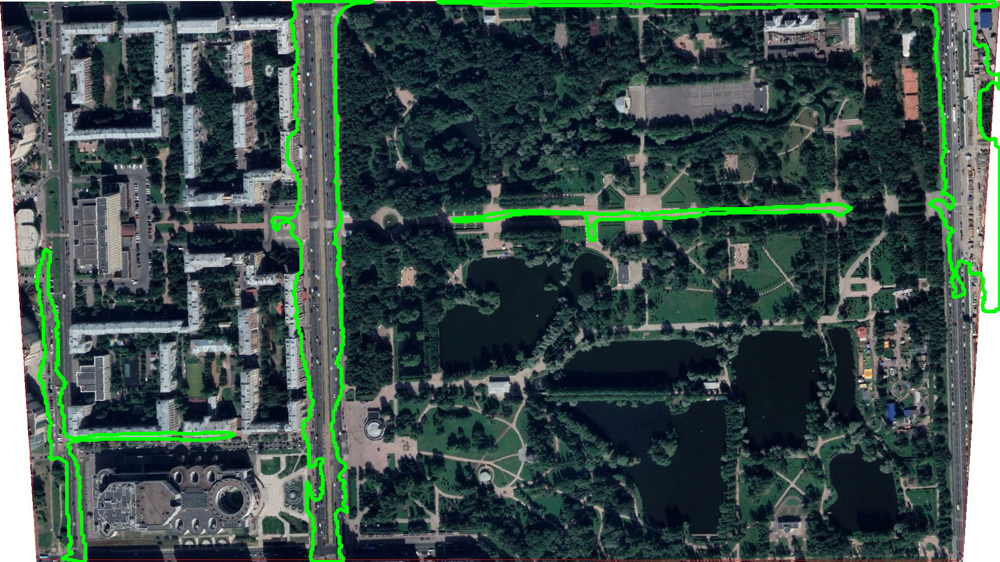

In [84]:
contours = anomaly_roads.find_contours_of_anomaly()
contour_img = draw_contours(contours, image_RGB.copy())
contour_img_pill = Image.fromarray(contour_img)
contour_img_pill.show()

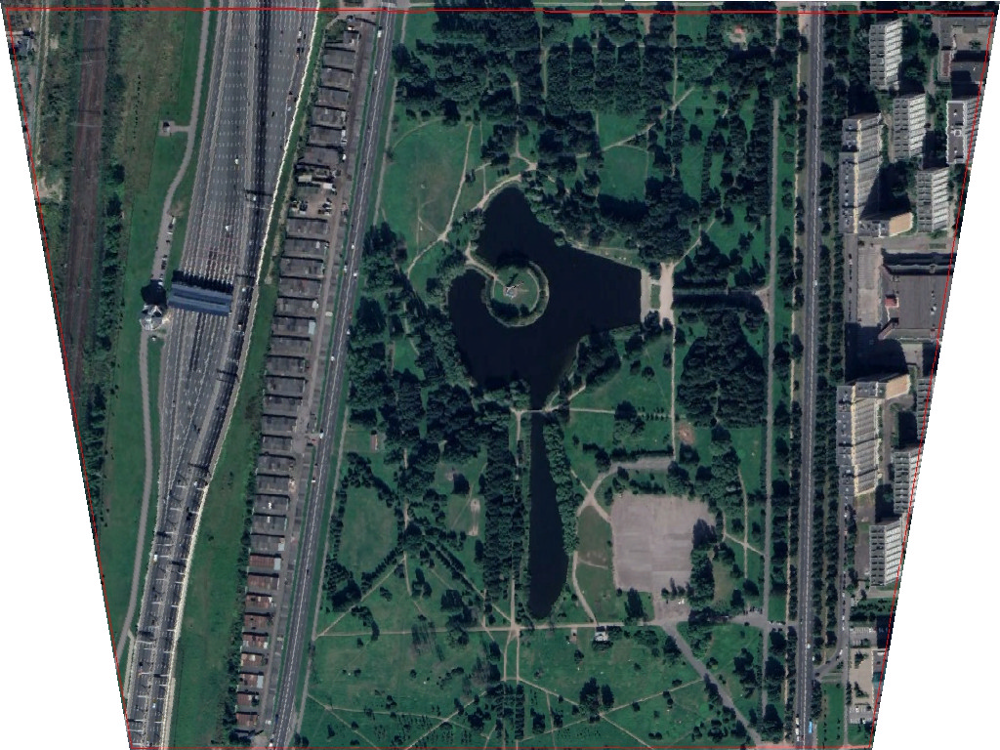

In [15]:
FILENAME = 'park_2.tif'
image_RGB = get_image_RGB_2(FILENAME)
image_pill = Image.fromarray(image_RGB)
image_pill.show()

anomaly_roads = AnomalyRoads(image_RGB, '/content/unet_road_3.h5')

(768, 1024, 3)
1/1 [==============================] - 6s 6s/step


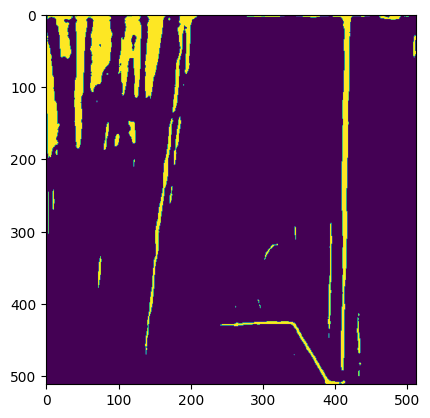

Mean area: 382.5777777777778 +- 833.8041666932721
42


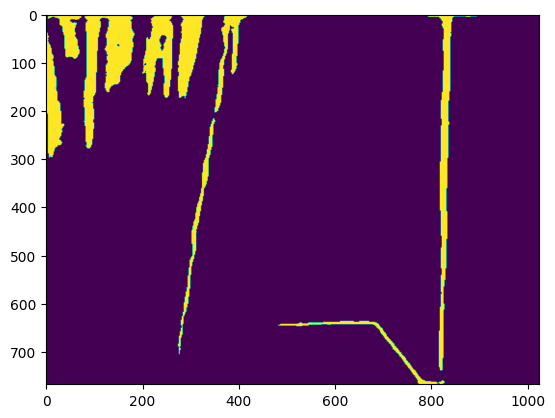

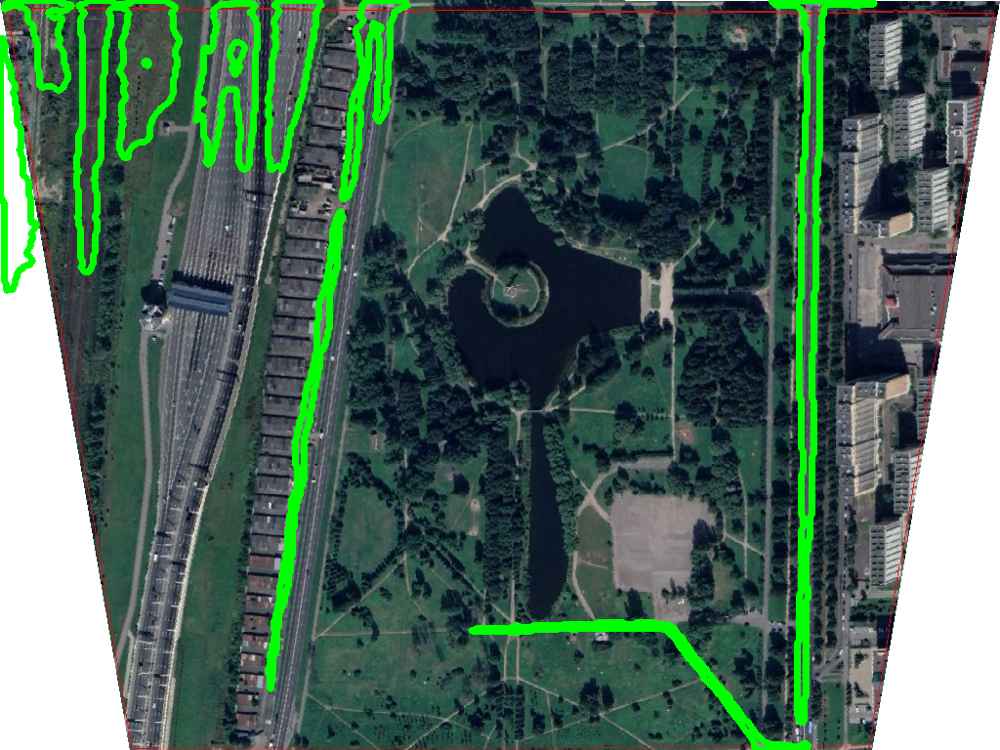

In [16]:
contours = anomaly_roads.find_contours_of_anomaly()
contour_img = draw_contours(contours, image_RGB.copy())
contour_img_pill = Image.fromarray(contour_img)
contour_img_pill.show()

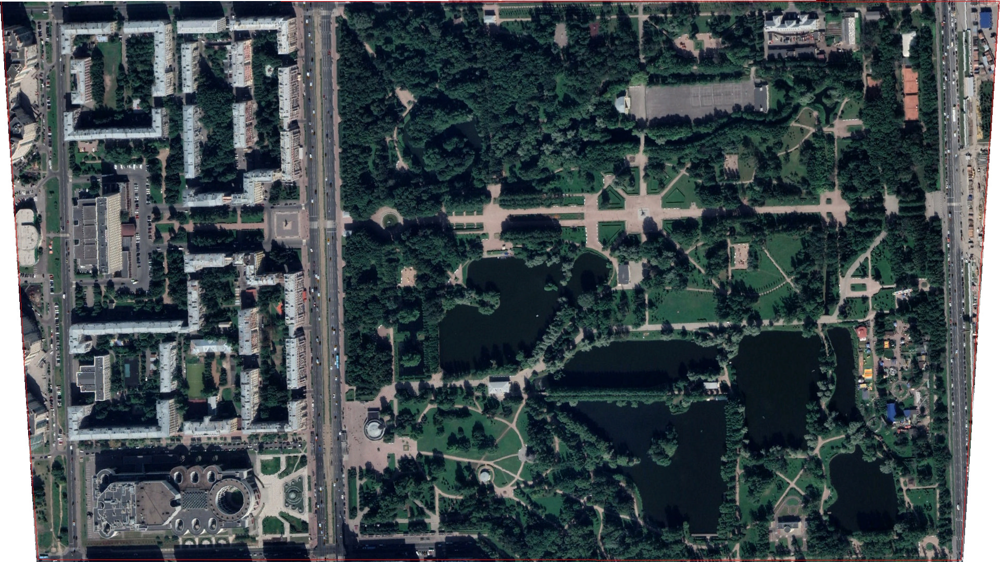

In [17]:
FILENAME = 'park_1.tif'
image_RGB = get_image_RGB_2(FILENAME)
image_pill = Image.fromarray(image_RGB)
image_pill.show()

anomaly_roads = AnomalyRoads(image_RGB, '/content/unet_road_3.h5')

(1080, 1920, 3)
1/1 [==============================] - 4s 4s/step


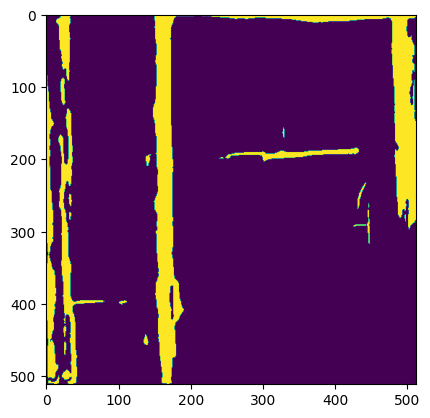

Mean area: 1208.9583333333333 +- 2810.691647963283
24


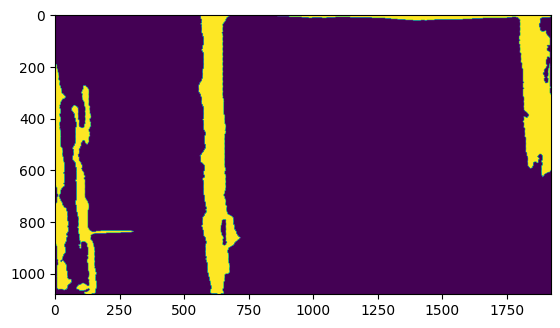

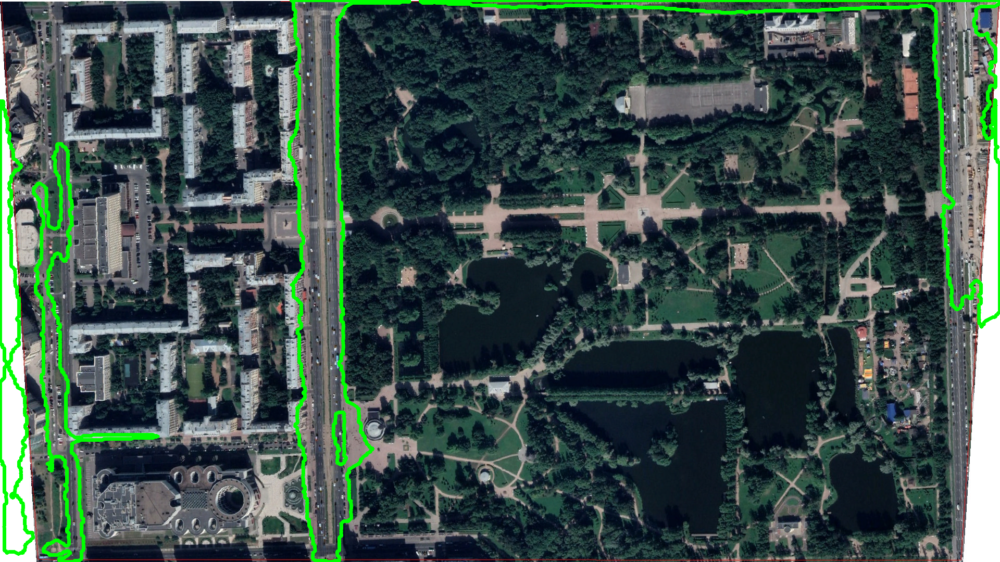

In [18]:
contours = anomaly_roads.find_contours_of_anomaly()
contour_img = draw_contours(contours, image_RGB.copy())
contour_img_pill = Image.fromarray(contour_img)
contour_img_pill.show()